In [5]:
import pandas as pd

# Load metadata
meta = pd.read_csv('training_set_metadata.csv')

# Filter: Deep Drilling Fields (ddf == 1) AND SNIa (target == 90)
snia_90_ddf_1 = meta[(meta['ddf'] == 1) & (meta['target'] == 90)]

# Check the number of events
print(f"Number of DDF SNIa: {len(snia_90_ddf_1)}")  # Should be 837

print(snia_90_ddf_1.to_string(index=False))

Number of DDF SNIa: 837
 object_id         ra       decl      gal_l      gal_b  ddf  hostgal_specz  hostgal_photoz  hostgal_photoz_err  distmod  mwebv  target
       745   0.189873 -45.586655 328.254458 -68.969298    1         0.3037          0.2813              1.1523  40.7951  0.007      90
      1124 352.711273 -63.823658 316.922299 -51.059403    1         0.1934          0.2415              0.0176  40.4166  0.024      90
      1598 347.846710 -64.760857 318.929827 -49.143596    1         0.1352          0.1820              0.0304  39.7279  0.019      90
      1920 149.414062   3.433834 234.919132  42.245550    1         0.3088          0.3229              0.3360  41.1401  0.027      90
      2072   0.965665 -46.375080 325.845907 -68.579427    1         0.1516          0.1900              0.0104  39.8317  0.007      90
      2330 359.805206 -46.768478 327.135979 -67.829903    1         0.4541          0.5736              0.2827  42.6207  0.011      90
      4389 151.699219   3.58332

In [6]:
import pandas as pd

# Load light curve data
lc = pd.read_csv('training_set.csv')

# Filtered metadata (assuming it's already created as snia_90_ddf_1)
# Keep only light curve rows matching filtered SNIa object_ids
snia_lc_ddf = lc[lc['object_id'].isin(snia_90_ddf_1['object_id'])]

# Sanity check
print(f"Unique SNIa object IDs in light curves: {snia_lc_ddf['object_id'].nunique()}")

# Print
print(snia_lc_ddf.to_string(index=False, header=True))

Unique SNIa object IDs in light curves: 837
 object_id        mjd  passband         flux   flux_err  detected
       745 59770.3662         2     0.161398   0.619084         0
       745 59770.3740         1    -0.699347   0.602597         0
       745 59770.3817         3    -1.623621   1.051044         0
       745 59770.3928         4     2.732148   1.807272         0
       745 59770.4039         5     0.529565   4.609781         0
       745 59779.3999         2     2.314143   2.049559         0
       745 59779.4075         1     3.819682   2.775676         0
       745 59779.4151         3     7.149204   2.455586         0
       745 59779.4261         4    -0.612280   3.263342         0
       745 59779.4370         5    12.491076   8.552037         0
       745 59782.2372         2     0.351617   1.218648         0
       745 59782.2450         1     1.318436   1.148711         0
       745 59782.2527         3    -2.479718   2.057880         0
       745 59782.2639         4 

### Part a ###

Note: r-band is designated as passband = 2 in the traning_set.csv


In [43]:
import pandas as pd

## Step 1: Filter only r-band (passband == 2)
r_band_lightcurve = snia_lc_ddf[snia_lc_ddf['passband'] == 2]

## STEP 2: Find the brightest r-band flux for each supernova

# First, group the data so we’re looking at each supernova separately
grouped = r_band_lightcurve.groupby('object_id')

# Then find the row index where each SN has its brightest r-band flux
max_flux_indices = grouped['flux'].idxmax()

# Grab those rows — they contain the actual observations with max flux
brightest_r_band_obs = r_band_lightcurve.loc[max_flux_indices]

## STEP 3: Extract object_id, mjd (time), and flux and rename columns

# Just keep the columns we care about: object_id, mjd (time), and flux
r_band_peaks = brightest_r_band_obs[['object_id', 'mjd', 'flux']]

# Rename the columns so they match what the assignment is asking for
r_band_peaks = r_band_peaks.rename(columns={
    'mjd': 'Tr_max',   # Time of max r-band flux
    'flux': 'Fr_max'   # Value of max r-band flux
})

# to make output more sensical and pretty looking.
r_band_peaks = r_band_peaks.reset_index(drop=True)

# Optional: preview result
print(r_band_peaks.head())

   object_id      Tr_max       Fr_max
0        745  60125.4094   220.795212
1       1124  60490.2647   106.671692
2       1598  60624.1760  1289.851440
3       1920  59991.1150   231.828339
4       2072  59770.3662    19.925980


### Part b and part d


   object_id      Tr_max       Fr_max    zcmb   mu_r_max
0        745  60125.4094   220.795212  0.3037  40.927970
1       1124  60490.2647   106.671692  0.1934  41.621842
2       1598  60624.1760  1289.851440  0.1352  38.861332
3       1920  59991.1150   231.828339  0.3088  40.879267
4       2072  59770.3662    19.925980  0.1516  43.404705


<Figure size 800x600 with 0 Axes>

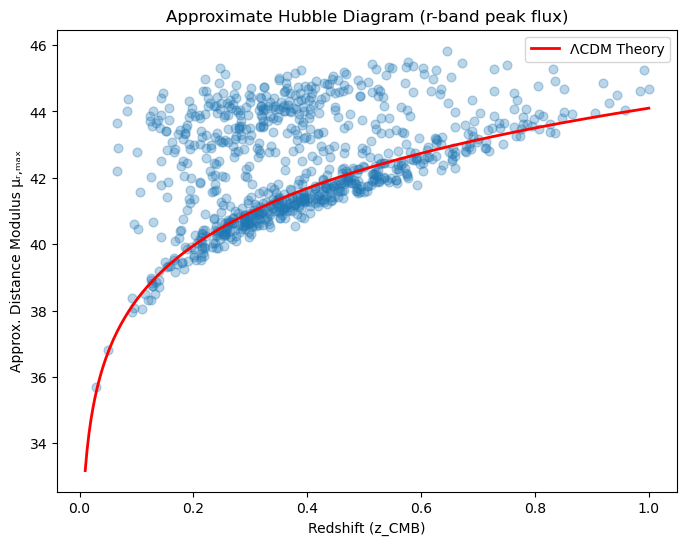

In [44]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.cosmology import FlatLambdaCDM


# Merge in redshift from metadata
r_band_peaks = r_band_peaks.merge(
    snia_90_ddf_1[['object_id', 'hostgal_specz']],
    on='object_id'
)

# Rename for clarity
r_band_peaks = r_band_peaks.rename(columns={'hostgal_specz': 'zcmb'})

# Define constants
Zcal = 27.5
M0 = -19

# Compute approximate distance modulus μ_r,max
r_band_peaks['mu_r_max'] = (
    Zcal
    - 2.5 * np.log10(r_band_peaks['Fr_max'])
    - M0
    + 2.5 * np.log10(1 + r_band_peaks['zcmb'])
)

print(r_band_peaks.head())

# Define ΛCDM cosmology
cosmo = FlatLambdaCDM(H0=70, Om0=0.3)

# Generate redshift values for theory curve
z_theory = np.linspace(0.01, 1.0, 300)  # Avoid z=0 to prevent log(0)
mu_theory = cosmo.distmod(z_theory).value

# Create the plot
plt.figure(figsize=(8,6))



# Create the plot
plt.figure(figsize=(8,6))
plt.scatter(r_band_peaks['zcmb'], r_band_peaks['mu_r_max'], s=40, alpha=0.3)

# Plot the theoretical curve
plt.plot(z_theory, mu_theory, color='red', label='ΛCDM Theory', linewidth=2)
plt.legend()

# Label the axes
plt.xlabel('Redshift (z_CMB)')
plt.ylabel('Approx. Distance Modulus μᵣ,ₘₐₓ')
plt.title('Approximate Hubble Diagram (r-band peak flux)')

# Optional: make it look nice
plt.show()

## Part (e)

 object_id        mjd  passband         flux   flux_err  detected     Tr_max  days_from_peak
       745 59770.3662         2     0.161398   0.619084         0 60125.4094       -355.0432
       745 59779.3999         2     2.314143   2.049559         0 60125.4094       -346.0095
       745 59782.2372         2     0.351617   1.218648         0 60125.4094       -343.1722
       745 59797.3336         2    -1.537819   0.984894         0 60125.4094       -328.0758
       745 59800.2328         2    -1.516613   2.289521         0 60125.4094       -325.1766
       745 59808.2223         2    -0.847675   1.376511         0 60125.4094       -317.1871
       745 59811.1280         2     0.494487   1.087227         0 60125.4094       -314.2814
       745 59814.1206         2    -1.073968   0.907784         0 60125.4094       -311.2888
       745 59826.3574         2    -2.159753   0.886318         0 60125.4094       -299.0520
       745 59836.1402         2     0.447286   1.399731         0 6012

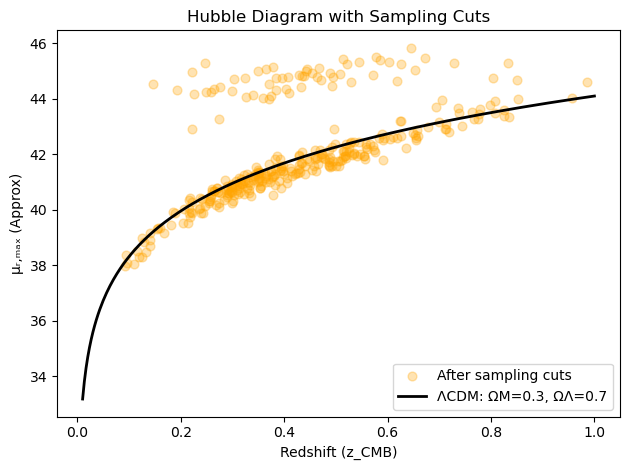

In [ ]:

## Merge Tr_max into r-band light curve data
# note: r_band_lightcurve is ALL r-band data, not just peaks
# when we merge on ojbect id, we will have one Tr_max broadcast across each SNIa
merged = r_band_lightcurve.merge(r_band_peaks[['object_id', 'Tr_max']], on='object_id')

## STEP 1: Compute the days from peak for each observation (i.e. time offset from Tr_max)
merged['days_from_peak'] = merged['mjd'] - merged['Tr_max']

print(merged.to_string(index=False, header=True))

## STEP 2: Filter acceptable observations

# Check if each SN meets the sampling cut criteria
def passes_sampling_cuts(df):
    pre_peak = df['days_from_peak'].between(-20, -5).any()
    post_peak = df['days_from_peak'].between(10, 40).any()
    return pre_peak and post_peak

# Group by SN and check which ones pass criteria of having at least one observation
# before peak (between -20 and -5 days) and at least one after peak (between 10 and 40 days)

## Group the merged light curves by object_id
grouped = merged.groupby('object_id')

## Filter groups that meet the sampling criteria
# note: what we're basically saying here is this:
# “Hey pandas, for each group, call passes_sampling_cuts(group_df) and 
# keep the group if it returns True.” This is how we can call
# upon passes_sampling_cuts without explicitly looping through each group 
# or inputting a dataframe into it.
passed_groups = grouped.filter(passes_sampling_cuts)

## Grab unique object_ids that passed the sampling cuts
passed_ids = passed_groups['object_id'].unique()

# Make a mask for rows that have object_id in the list of passed IDs
is_passing_sn = r_band_peaks['object_id'].isin(passed_ids)

# Use the mask to filter the DataFrame
r_band_peaks_cut = r_band_peaks[is_passing_sn]

plt.scatter(r_band_peaks_cut['zcmb'], r_band_peaks_cut['mu_r_max'], color='orange', s=40, alpha=0.3, label='After sampling cuts')
plt.plot(z_theory, mu_theory, color='black', linewidth=2, label='ΛCDM: ΩM=0.3, ΩΛ=0.7')

plt.xlabel('Redshift (z_CMB)')
plt.ylabel('μᵣ,ₘₐₓ (Approx)')
plt.title('Hubble Diagram with Sampling Cuts')
plt.legend()
plt.tight_layout()
plt.show()